<p><a name="sections"></a></p>


# Table of Contents

- <a href="#exploratory">Exploratory Data Analysis</a>
    - <a href="#overtime">Music Over Time</a>
    - <a href="#diffgenres">Characteristics of Different Genres</a>
    
- <a href="#clustergenres">Clustering Genres</a>

- <a href="#clustersongs">Clustering Songs</a>

- <a href="#contentrec">Building Content Based Recommender</a>
  
<!--   - <a href="#nList">Nested Lists</a>
- <a href="#funcOper">Functional Operators</a>
  - <a href="#map">map</a>
  - <a href="#bool">Boolean Functions</a>
  - <a href="#filter">filter</a>
- <a href="#multiList">Multiple-list Operations
- <a href="#string">String operations</a>
 - <a href="#strBasic">String Basics</a>
 - <a href="#OMC">Object Method and Class Method Calls</a>
 - <a href="#buildin">Built-in Strings Operations</a>
 - <a href="#MinMap">Object Method Calls in map</a>
 - <a href="#case">Case conversion</a>
- <a href="#sol">Solutions</a> --> -->

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import spotipy
import datapane as dp
import chart_studio.plotly as py
import chart_studio
import os
chart_studio.tools.set_credentials_file(username='nick3lworks', api_key='MiLMdzHRgSYyn18hQa4w')
plt.rcParams.update({'font.size': 22})
%matplotlib inline

In [10]:
spotify_data = pd.read_csv('./raw_data/data.csv')
genre_data = pd.read_csv('./raw_data/data_by_genres.csv')
data_by_year = pd.read_csv('./raw_data/data_by_year.csv')
genre_data.head(150)

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,1,austin americana,0.392044,0.571604,2.789786e+05,0.622635,0.008585,0.226881,-7.121667,0.076842,112.860208,0.486312,50.656250,7
146,1,austin singer-songwriter,0.475698,0.539542,2.917572e+05,0.631479,0.033681,0.312617,-9.730500,0.062721,127.613396,0.537865,41.166667,9
147,1,austindie,0.329137,0.605551,2.411834e+05,0.631615,0.054387,0.161712,-7.344635,0.054124,108.676654,0.589506,50.948718,9
148,1,australian alternative pop,0.683729,0.484417,2.504632e+05,0.395974,0.007340,0.143367,-8.909017,0.044388,122.809417,0.133503,63.043478,5


In [11]:
data_by_year.head(5)

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


In [12]:
spotify_data.head(100)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.2110,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.3410,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.1660,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.3090,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.1930,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,0.1730,1921,0.992,['Morton Downey'],0.380,170240,0.1170,0,3tEwdlwf8ZrxpksJorI5Tc,0.000001,7,0.1050,-13.298,1,That's How You Spell Ireland,0,1921,0.0415,86.493
96,0.2190,1921,0.672,['Mehmet Kemiksiz'],0.403,396356,0.3850,0,47LO5zrjx6ShMymLqp80ef,0.000339,11,0.2110,-6.507,0,Şühedâ Gövdesi Bir Baksana Dağlar Taşlar,0,1921,0.0315,123.839
97,0.9190,1921,0.959,['Morton Downey'],0.829,153827,0.3330,0,4BWXQSxvAa73YTLVLlMtGp,0.000362,5,0.0841,-11.895,1,It's the Same Old Shillelegh,0,1921,0.1030,132.606
98,0.4510,1921,0.995,['Ignacio Corsini'],0.592,168053,0.0322,0,4Rv29R4ydhHN9tYPfrZxTz,0.057300,5,0.2970,-25.844,0,China Hereje - Remasterizado,0,1921-03-20,0.2090,69.958


In [13]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [14]:
data_by_year.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [15]:
spotify_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

<p><a name="exploratory"></a></p>

## Exploratory Data Analysis

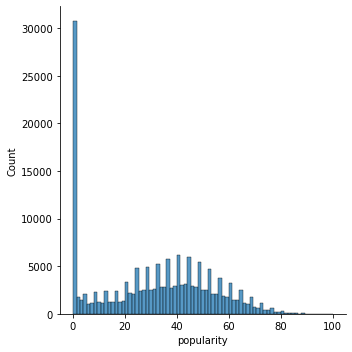

In [16]:
sns.displot(spotify_data['popularity'])

<p><a name="musicOT"></a></p>

### Music Over Time

In [17]:
def get_decade(year): 
    period_start = int(year/10) * 10
    decade = "{}s".format(period_start)
    
    return decade

In [18]:
spotify_data['decade'] = spotify_data['year'].apply(get_decade)

/Users/nicole/opt/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='decade', ylabel='count'>

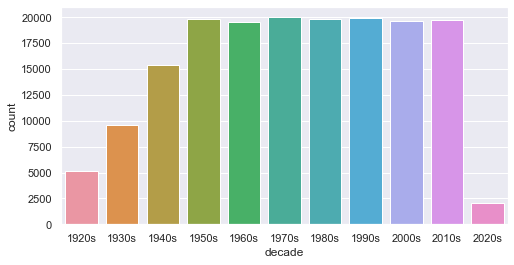

In [19]:
sns.set(rc={'figure.figsize':(8,4)})
sns.countplot(spotify_data['decade'])

In [20]:
import plotly.express as px

sound_features = ['acousticness','danceability','energy','instrumentalness','liveness','valence']
fig = px.line(data_by_year, x='year', y=sound_features)
fig.update_layout({'font_color':'rgba(255, 255, 255, 0.8)', 'paper_bgcolor': 'rgba(26, 24, 25, 0.8)','legend_bgcolor': 'rgba(190, 203, 227, .65)' })

fig.show()

report = dp.Report(dp.Plot(fig))
report.upload(name="music_over_time")


Bokeh version 2.3.2 is not supported, these plots may not display correctly, please install version ~=2.2.0


Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? Check out [the docs](https://docs.datapane.com/reports/blocks/layout-pages-and-selects) for more info

Report successfully uploaded, click [here](https://datapane.com/u/nickelworks/reports/9ArDwX7/music-over-time/) to view and share your report.

In [21]:
fig2 = px.line(data_by_year, x='year', y='tempo')
fig2.update_layout({'font_color':'rgba(255, 255, 255, 0.8)', 'paper_bgcolor': 'rgba(26, 24, 25, 0.8)','legend_bgcolor': 'rgba(190, 203, 227, .65)' })
fig2.show()


report = dp.Report(dp.Plot(fig2))
report.upload(name="tempo_over_time")

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? Check out [the docs](https://docs.datapane.com/reports/blocks/layout-pages-and-selects) for more info

Report successfully uploaded, click [here](https://datapane.com/u/nickelworks/reports/BAmpaok/tempo-over-time/) to view and share your report.

<p><a name="diffgenres"></a></p>

### Characteristics of Different Genres

In [22]:
top10_genres = genre_data.nlargest(10, 'popularity')
top10_genres

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
237,1,basshall,0.213167,0.81800,169799.166667,0.630167,0.000020,0.081067,-6.627833,0.134833,115.092500,0.588667,80.666667,2
2533,1,south african house,0.043833,0.84700,311854.333333,0.562333,0.130339,0.075133,-7.719000,0.050733,123.676333,0.834333,80.000000,1
2755,1,trap venezolano,0.044600,0.87700,231848.000000,0.777000,0.000035,0.086300,-4.246000,0.117000,102.020000,0.706000,80.000000,1
2778,0,turkish edm,0.008290,0.69800,186700.000000,0.719000,0.000004,0.326000,-4.923000,0.045500,120.062000,0.364000,80.000000,0
46,0,alberta hip hop,0.330000,0.88500,144000.000000,0.685000,0.000000,0.148000,-6.429000,0.062700,99.954000,0.937000,78.500000,11
536,0,chinese electropop,0.002570,0.66000,217088.000000,0.787000,0.000000,0.323000,-4.592000,0.032000,142.018000,0.199000,78.500000,1
37,0,afroswing,0.318450,0.71175,179995.375000,0.580187,0.000258,0.189950,-7.016687,0.195563,83.250125,0.676625,77.312500,11
31,0,afro soul,0.006270,0.76600,202627.000000,0.873000,0.000000,0.076400,-6.381000,0.143000,126.988000,0.743000,77.000000,11
575,1,circuit,0.009030,0.74500,189818.000000,0.972000,0.465000,0.297000,-3.506000,0.077400,128.031000,0.556000,77.000000,7
1239,1,guaracha,0.009030,0.74500,189818.000000,0.972000,0.465000,0.297000,-3.506000,0.077400,128.031000,0.556000,77.000000,7


In [26]:
fig3 = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')

fig3.show()

<p><a name="clustergenres"></a></p>

## Clustering Genres

In [27]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10, n_jobs=-1))])

X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

/Users/nicole/opt/anaconda3/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:792: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).



In [28]:
from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=2))])
genre_embedding = tsne_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.003s...
[t-SNE] Computed neighbors for 2973 samples in 0.192s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] Computed conditional probabilities in 0.087s
[t-SNE] Iteration 50: error = 81.9343109, gradient norm = 0.0183132 (50 iterations in 0.646s)
[t-SNE] Iteration 100: error = 76.7518311, gradient norm = 0.0097950 (50 iterations in 0.519s)
[t-SNE] Iteration 150: error = 76.1361694, gradient norm = 0.0016686 (50 iterations in 0.505s)
[t-SNE] Iteration 200: error = 76.1104736, gradient norm = 0.0002360 (50 iterations in 0.501s)
[t-SNE] Iteration 250: error = 76.1079559, gradient norm = 0.0001435 (50 iterations in 0.509s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.107956
[t-SNE] Iteration 300: erro

In [29]:
import plotly.express as px

fig3 = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig3.show()

report = dp.Report(dp.Plot(fig3))
report.upload(name="Clustering Genres")

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? Check out [the docs](https://docs.datapane.com/reports/blocks/layout-pages-and-selects) for more info

Report successfully uploaded, click [here](https://datapane.com/u/nickelworks/reports/E7PXzq7/clustering-genres/) to view and share your report.

In [31]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=2, n_jobs=4))], verbose=True)
X = spotify_data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)

song_cluster_labels = song_cluster_pipeline.predict(X)
spotify_data['cluster_label'] = song_cluster_labels

[Pipeline] ............ (step 1 of 2) Processing scaler, total=   0.0s
Initialization complete


/Users/nicole/opt/anaconda3/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:792: FutureWarning:

'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).



Iteration 0, inertia 1628629.2243690786
Iteration 1, inertia 1180545.8203270342
Iteration 2, inertia 1120259.3641931026
Iteration 3, inertia 1102994.8255131904
Iteration 4, inertia 1096785.816627659
Iteration 5, inertia 1092112.3520717204
Iteration 6, inertia 1087082.0002958477
Iteration 7, inertia 1085264.8934536693
Iteration 8, inertia 1083812.2824475013
Iteration 9, inertia 1081908.0596034455
Iteration 10, inertia 1079491.1314198242
Iteration 11, inertia 1077028.4118433543
Iteration 12, inertia 1075102.1388444302
Iteration 13, inertia 1073889.312172178
Iteration 14, inertia 1073076.4532006166
Iteration 15, inertia 1072450.7452464236
Iteration 16, inertia 1071963.0466129354
Iteration 17, inertia 1071596.7859052273
Iteration 18, inertia 1071314.894862173
Iteration 19, inertia 1071131.6135602489
Iteration 20, inertia 1071018.3186781285
Iteration 21, inertia 1070955.8491792884
Iteration 22, inertia 1070923.9975155732
Iteration 23, inertia 1070906.7759691332
Iteration 24, inertia 1070895

Iteration 15, inertia 1075668.9018613754
Iteration 16, inertia 1075660.3777331507
Iteration 17, inertia 1075655.1955840613
Iteration 18, inertia 1075652.6527066901
Iteration 19, inertia 1075651.6424164826
Converged at iteration 19: center shift 8.090576438072148e-05 within tolerance 0.00010000000000000724.
Initialization complete
Iteration 0, inertia 1604727.4414338719
Iteration 1, inertia 1176998.961365151
Iteration 2, inertia 1125081.4247500724
Iteration 3, inertia 1109723.0529101994
Iteration 4, inertia 1100249.3148666208
Iteration 5, inertia 1092808.6586707076
Iteration 6, inertia 1087733.3013979422
Iteration 7, inertia 1084970.2459158704
Iteration 8, inertia 1084154.6713866047
Iteration 9, inertia 1083208.473241415
Iteration 10, inertia 1081075.7358424757
Iteration 11, inertia 1077387.365170583
Iteration 12, inertia 1074141.3900161546
Iteration 13, inertia 1071964.6823068068
Iteration 14, inertia 1070466.9215145905
Iteration 15, inertia 1069439.9794493702
Iteration 16, inertia 106

<p><a name="clustersongs"></a></p>

## Clustering Songs

In [33]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)

projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = spotify_data['name']
projection['cluster'] = spotify_data['cluster_label']

In [35]:
import plotly.express as px

fig4 = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig4.show()

report = dp.Report(dp.Plot(fig4))
report.upload(name="Clustering Songs")

Uploading report and associated data - *please wait...*

Your report only contains a single element - did you know you can include additional plots, tables and text in a single report? Check out [the docs](https://docs.datapane.com/reports/blocks/layout-pages-and-selects) for more info

Report successfully uploaded, click [here](https://datapane.com/u/nickelworks/reports/aAMZP93/clustering-songs/) to view and share your report.

<p><a name="contentrec"></a></p>

## Building Content Based Recommender

In [36]:
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id='0409546ff8f6448e8fb751c48f25cacb',
                                                           client_secret='9e57d22b7684495e82e9404ed51d6bc5'))


def find_song(name, year):
    
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,
                                                       year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    results = results['tracks']['items'][0]

    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]
    
    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]
    
    for key, value in audio_features.items():
        song_data[key] = value
    
    return pd.DataFrame(song_data)

In [37]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

def get_song_data(song, spotify_data):
    
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        return song_data
    
    except IndexError:
        return find_song(song['name'], song['year'])
        
def get_mean_vector(song_list, spotify_data):
    
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

def flatten_dict_list(dict_list):
    
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict
        
def recommend_songs( song_list, spotify_data, n_songs=10):
    
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [38]:
recommend_songs([{'name': 'Come As You Are', 'year':1991},
                {'name': 'Smells Like Teen Spirit', 'year': 1991},
                {'name': 'Lithium', 'year': 1992},
                {'name': 'All Apologies', 'year': 1993},
                {'name': 'Stay Away', 'year': 1993}],  spotify_data)

<ipython-input-37-d08731f82234>:31: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



ValueError: X has 15 features, but StandardScaler is expecting 16 features as input.

In [40]:
recommend_songs([{'name':'Beat It', 'year': 1982},
                 {'name': 'Billie Jean', 'year': 1988},
                 {'name': 'Thriller', 'year': 1982}], spotify_data)

<ipython-input-37-d08731f82234>:31: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



ValueError: X has 15 features, but StandardScaler is expecting 16 features as input.